# Impact of Drought on the Leaf Area Index in Yunnan Province, China

Production date: 15-09-2025

Produced by: Amaya Camila Trigoso Barrientos (VUB)

## 🌍 Use case: Utilize satellite derived data to study the effect of drought periods on vegetation

## ❓ Quality assessment question(s)
* **Does version 3 of the C3S LAI dataset (derived from SPOT satellite imagery) provide sufficient temporal and spatial completeness to capture the impact of the 2009–2010 drought on vegetation in Yunnan Province?**
* **How does the choice of relevant quality flags affect product spatial and temporal completeness?**

The Leaf Area Index (LAI) and Fraction of Absorbed Photosynthetically Active Radiation (fAPAR) dataset, provided by the Climate Data Store (C3S), offers 10-daily gridded observations from 1981 to the present. It includes effective LAI values derived from multiple satellite sensors across different product versions. Effective LAI is defined as half the total surface area of photosynthetically active plant elements per unit of horizontal ground area. It relates to true LAI through a canopy-dependent structure factor. As a key biophysical parameter, LAI is widely used to assess vegetation status, monitor ecosystem dynamics, and inform environmental and agricultural decision-making.

This quality assessment uses version 3 of the LAI product, selected because it covers the study period from 2007 to 2013. During this time, data were obtained from the System Pour l'Observation de la Terre (SPOT) satellite, Vegetation (VGT) sensor, with a spatial resolution of 1 km and a 10-day temporal resolution. The dataset is evaluated over Yunnan Province, China, with particular attention to the 2009-2010 drought.

The objectives of this assessment are: first, to assess whether the product's spatial and temporal completeness is sufficient to capture drought-related changes in LAI, which serves as a proxy for vegetation health; and second, to evaluate how different choices of quality flags influence the analysis.

## 📢 Quality assessment statement

```{admonition} These are the key outcomes of this assessment
:class: note
* Applying a relaxed quality filter (bitmask 0x9C1) significantly increases LAI data availability during the wet season in Yunnan, maintaining over 84% completeness. However, this comes at the cost of increased uncertainty, as it includes pixels affected by albedo-related issues.
* The conservative filter (bitmask 0xFC1), which excludes all flagged data, severely limits completeness during wet months, particularly from June to August, and especially in densely vegetated areas such as evergreen and mixed forests. However, this filter can be applied during the dry season with high completeness, while maintaining higher standards of data reliability.
* The standardized LAI anomaly in Yunnan’s Tropic of Cancer zone was predominantly negative in March 2010, with extensive negative values also observed in the adjacent months, indicating that this period represents the strongest drought-related impact on LAI. This pattern is mostly consistent with the observations reported by Zhang et al. (2024) [[1]](https://doi.org/10.1038/s41598-024-58068-w).
```

## 📋 Methodology

The LAI variable from version 3 of the C3S product was downloaded for the period 2007-2013 and clipped to Yunnan Province, China. Two different quality filters were applied to the data: bitmask 0xFC1 (hereafter referred to as the conservative filter) and bitmask 0xFC1 (hereafter referred to as the relaxed filter). For each month in the study period, the percentage of completeness (the fraction of pixels that are not missing) was calculated under both filters for comparison. A date exhibiting a large difference in completeness between filters was selected, and the corresponding LAI map was visually compared with a land cover map to identify whether specific land cover types or zones were disproportionately affected by missing data. Monthly mean LAI over the entire province was then calculated and plotted for each year to assess whether the 2009-2010 drought is evident as lower LAI relative to other years. This analysis was performed for both filters to allow comparison. Finally, standardized LAI anomalies were calculated for Yunnan's Tropic of Cancer zone, and the results were compared with those reported by Zhang et al. (2024) [[1]](https://doi.org/10.1038/s41598-024-58068-w).

The analysis and results are organised in the following steps, which are detailed in the sections below: 

**[](section-1)**  
* Download LAI data from the SPOT satellite (VGT sensor) for the period 2007-2013.

**[](section-2)**  
* Apply two distinct quality-masking approaches to filter the data.  
* Plot the percentage of valid LAI values over time for each approach.  
* Map LAI across Yunnan to compare the results from the two quality-masking methods.  
* Analyze the outcomes in relation to the dataset Documentation.

**[](section-3)**  
* Calculate the spatial and monthly mean LAI, and plot the values for each year over the months of the year. Compare the results for the relaxed and the conservative filters.
* Map LAI anomalies in Yunnan's Tropic of Cancer zone for the drought period from August 2009 to October 2010, relative to the reference years 2007-2008 and 2012-2013.

## 📈 Analysis and results

(section-1)=
### 1. Request and download data

#### Import packages

In [23]:
import matplotlib.pyplot as plt
import pandas as pd
import shapely.geometry
import regionmask
import xarray as xr
import os
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import requests as reqlib
import geopandas as gpd
import rioxarray
import matplotlib.colors as mcolors
from matplotlib import animation, pyplot as plt
from matplotlib.colors import LinearSegmentedColormap, ListedColormap, BoundaryNorm, Normalize
from matplotlib.animation import FuncAnimation, PillowWriter
from c3s_eqc_automatic_quality_control import diagnostics, download
import matplotlib.cm as cm
from matplotlib.transforms import blended_transform_factory
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import calendar
from IPython.display import HTML, display
os.environ["CDSAPI_RC"] = os.path.expanduser("~/trigoso_camila/.cdsapirc")
plt.style.use("seaborn-v0_8-notebook")

#### Set parameters

In [2]:
year_start = 2007
year_stop = 2013

#### Define requests

In [3]:
collection_id = "satellite-lai-fapar"
base_request = {
    "variable": "lai",
    "sensor": "vgt",
    "horizontal_resolution": "1km",
    "product_version": "v3",
    "area": [53, 73, 18, 135],
}

requests = []
for time in pd.date_range(str(year_start), str(year_stop + 1), freq="ME"):
    requests.append(
        base_request
        | {
            "satellite": "spot",
            "year": str(time.year),
            "month": f"{time.month:02d}",
            "nominal_day": ["10", "20", str(time.day)],
        }
    )

In [4]:
def mask_dataset_with_shapefile(ds):
    # Load the provinces (level 1)
    gdf = gpd.read_file(
        "zip+https://geodata.ucdavis.edu/gadm/gadm4.1/shp/gadm41_CHN_shp.zip",
        layer="gadm41_CHN_1"
    )

    # Filter only Yunnan
    gdf_yunnan = gdf[gdf["NAME_1"] == "Yunnan"]

    # Reproject to EPSG:4326 (if needed)
    gdf_yunnan = gdf_yunnan.to_crs("EPSG:4326")

    # Ensure dataset has a CRS
    if not ds.rio.crs:
        ds = ds.rio.write_crs("EPSG:4326")

    # Clip dataset with Yunnan boundary
    ds_masked = ds.rio.clip(gdf_yunnan.geometry, gdf_yunnan.crs, drop=False, invert=False)

    return ds_masked

#### Download and transform

In [5]:
ds = download.download_and_transform(
    collection_id,
    requests,
    transform_func=mask_dataset_with_shapefile
)

100%|██████████| 84/84 [00:48<00:00,  1.72it/s]


In [6]:
ds = ds.sel(
    longitude=slice(97.53, 106.19),
    latitude=slice(29.23, 21.14)  # note: latitude is decreasing
)

(section-2)=
### 2. Completeness analysis

#### Filter data

In this step, the dataset was spatially subsetted using a shapefile of Yunnan, an inland province in southwestern China. The shapefile was accessed from the GADM Database of Global Administrative Areas (version 4.1) via the UC Davis GeoData repository [[2]](https://gadm.org).

To filter out unreliable data, two distinct quality-masking strategies were applied:

* **Conservative:** Retains only the highest-quality retrievals by applying bitmask 0xFC1. This mask excludes data flagged with any of the following bits: 0, 6, 7, 8, 9, 10, and 11, corresponding to missing input data, untrusted retrievals, unusable observations, inconsistent inputs, high albedo uncertainty (both snow and non-snow), and unreliable uncertainty estimates.
* **Relaxed filter:** Permits retrievals with high albedo uncertainty (considered still usable), using bitmask 0x9C1. This mask excludes a smaller subset of flags: bits 0, 6, 7, 8, and 11, while allowing data flagged only for high albedo uncertainty in non-snow and snow conditions (bits 9 and 10).

These bitmasks are defined in Table 2, with flag definitions detailed in Table 7 of the [Product User Guide and Specification PUGS](https://dast.copernicus-climate.eu/documents/satellite-lai-fapar/D3.3.9-v3.0_PUGS_CDR_LAI_FAPAR_MULTI_SENSOR_v3.0_PRODUCTS_v1.0.1.pdf). 

The goal of this comparison was to assess how different treatments of uncertainty flags affect data completeness over Yunnan, particularly during periods of increased retrieval uncertainty such as the rainy season.

In [7]:
def filter_conservative(ds):
    """
    Filters the dataset using a strict quality mask:
    Only keeps retrievals with all critical flags unset (bitmask 0xFC1).
    Requirement Table 2, PUGS: Best possible data with uncertainties.
    """
    quality_mask = (ds["retrieval_flag"].astype("int") & 0xFC1) == 0
    lai_mask = ds["LAI"] >= 0
    return ds.where(quality_mask & lai_mask)

def filter_relaxed(ds):
    """
    Filters the dataset using a relaxed quality mask:
    Allows uncertainty (bitmask 0x9C1).
    Requirement Table 2, PUGS: Ignore all issues caused by high albedo uncertainties
    """
    quality_mask = (ds["retrieval_flag"].astype("int") & 0x9C1) == 0
    lai_mask = ds["LAI"] >= 0
    return ds.where(quality_mask & lai_mask)


In [8]:
#Apply strict quality filtering
ds_conservative = filter_conservative(ds)

#Apply relaxed quality filtering
ds_relaxed = filter_relaxed(ds)

In [16]:
# Load Yunnan boundary from GADM
# Data accessed via UC Davis GeoData repository: https://geodata.ucdavis.edu/gadm/
url = "zip+https://geodata.ucdavis.edu/gadm/gadm4.1/shp/gadm41_CHN_shp.zip"
gdf = gpd.read_file(url, layer="gadm41_CHN_1")
gdf = gdf[gdf["NAME_1"] == "Yunnan"].to_crs("EPSG:4326")

In [18]:
def compute_valid_percentage_over_yunnan(ds, variable="LAI"):
    """
    Compute the percentage of valid pixels over Yunnan province for each timestep.

    Parameters
    ----------
    ds : xarray.Dataset
        Dataset with dimensions (time, latitude, longitude).
    variable : str, default="LAI"
        Name of the data variable to evaluate.

    Returns
    -------
    valid_percentage : xarray.DataArray
        Time series of percentage of valid pixels over Yunnan.
    """
    # Clean variable (NaNs, Infs)
    ds[variable] = ds[variable].where(np.isfinite(ds[variable]))

    # Ensure dataset CRS
    ds = ds.rio.write_crs("EPSG:4326")

    # Dummy mask grid (same lat/lon as ds)
    dummy = xr.full_like(ds[variable].isel(time=0), fill_value=1)
    dummy = dummy.rio.write_crs("EPSG:4326")

    # Clip dummy with Yunnan polygon
    clipped = dummy.rio.clip(gdf.geometry, gdf.crs, drop=False)
    region_mask = clipped.notnull()

    # Broadcast region mask to full dataset shape
    region_mask_3d = region_mask.broadcast_like(ds[variable])

    # Valid pixels = inside Yunnan & not null
    valid_mask = ds[variable].notnull() & region_mask_3d

    # Count valid pixels per time step
    valid_counts = valid_mask.sum(dim=["latitude", "longitude"]).compute()

    # Total Yunnan pixels (constant)
    total_yunnan_pixels = region_mask.sum().compute()

    # Percentage
    valid_percentage = (valid_counts / total_yunnan_pixels) * 100
    valid_percentage.name = f"{variable}_valid_percentage"

    return valid_percentage

In [19]:
def plot_valid_percentage_by_month(valid_percentage, title="Percentage of Valid Values Over Time"):
    """
    Scatter plot of valid percentage over time, colored by month.

    Parameters
    ----------
    valid_percentage : xarray.DataArray
        Time series of valid percentage (output from compute_valid_percentage_over_yunnan).
    title : str, default="Percentage of Valid Values Over Time"
        Title for the plot.
    """

    # --- Step 1: Extract months from time coordinate ---
    months = valid_percentage.time.dt.month

    # --- Step 2: Create rainbow colormap (1=Jan=red, 12=Dec=blue) ---
    colors = plt.cm.rainbow(np.linspace(0, 1, 12))  # 12 distinct colors
    month_colors = [colors[m - 1] for m in months.values]

    # --- Step 3: Scatter plot ---
    fig, ax = plt.subplots(figsize=(12, 6), dpi=250)
    scatter = ax.scatter(
        valid_percentage.time.values,
        valid_percentage.values,
        c=month_colors,
        s=20,
        alpha=0.7,
        edgecolors="black",
        linewidth=0.2
    )

    ax.set_title(title)
    ax.set_ylabel("Valid (%)")
    ax.set_xlabel("Time")
    ax.grid(True, alpha=0.3)

    # --- Step 4: Add colorbar showing month mapping ---
    sm = plt.cm.ScalarMappable(cmap=plt.cm.rainbow, norm=plt.Normalize(vmin=1, vmax=12))
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=ax, shrink=0.8)
    cbar.set_label("Month")
    cbar.set_ticks(range(1, 13))
    cbar.set_ticklabels(
        ["Jan", "Feb", "Mar", "Apr", "May", "Jun",
         "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
    )

    plt.tight_layout()
    plt.show()

In [20]:
# For your ds_conservative dataset:
valid_percentage_conservative = compute_valid_percentage_over_yunnan(ds_conservative, variable="LAI")

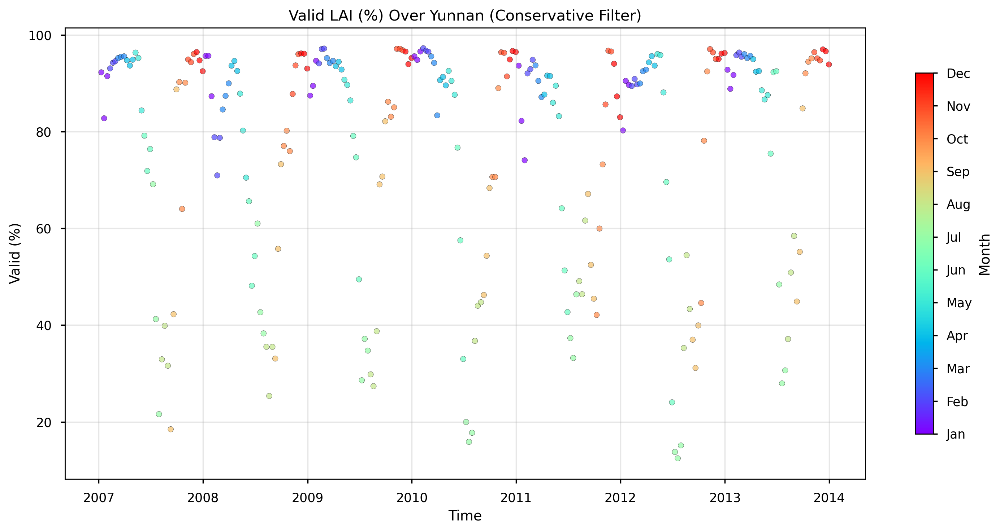

In [21]:
plot_valid_percentage_by_month(valid_percentage_conservative, 
                               title="Valid LAI (%) Over Yunnan (Conservative Filter)")

*Figure 1. Percentage of valid LAI values inside Yunnan area appliying the conservative mask (0xFC1). This percentage is plotted over time the points color coded for the month of each respective timestamp.*

In [23]:
valid_percentage_relaxed = compute_valid_percentage_over_yunnan(ds_relaxed, variable="LAI")

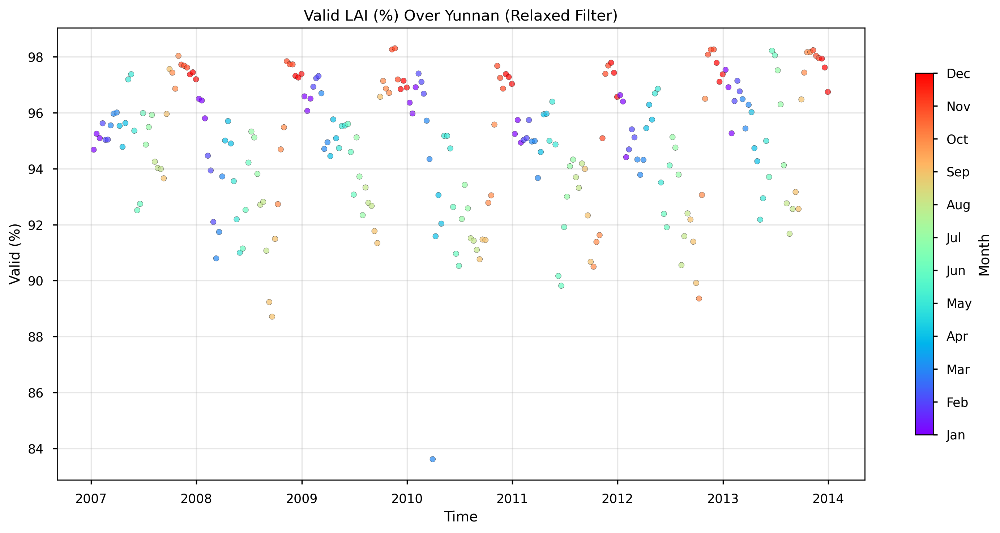

In [24]:
plot_valid_percentage_by_month(valid_percentage_relaxed, 
                               title="Valid LAI (%) Over Yunnan (Relaxed Filter)")

*Figure 2. Percentage of valid LAI values inside Yunnan area appliying the relaxed mask (0x9C1). This percentage is plotted over time the points color coded for the month of each respective timestamp. Note that the y-axis scale differs from Figure 1, ranging from 84% to 100%*

Using the conservative filter, the percentage of valid LAI data in Yunnan drops significantly between June and August, reaching levels below 20%. Adjacent months such as May and September also show reduced data completeness (see *Figure 1*). This pattern corresponds to Yunnan’s marked wet and dry seasons [[3]](https://doi.org/10.1016/j.chnaes.2013.09.004), where the rainy season leads to a higher frequency of missing observations and albedo-related uncertainties, mainly due to cloud cover and wet canopy conditions.

In contrast, when applying the relaxed filter, the percentage of valid LAI data remains consistently above 84% throughout the period studied (2007–2013) (see *Figure 2*). This improvement is due to the relaxed mask allowing pixels flagged only for high albedo uncertainty in both non-snow and snow conditions (bits 9 and 10). In this context, bit 9 often relates to reflectance disturbances caused by clouds or wet vegetation, which are prevalent in Yunnan during the rainy season. As shown in Figure 15 of the [PQAR](https://dast.copernicus-climate.eu/documents/satellite-lai-fapar/D2.3.9-v3.0_PQAR_CDR_LAI_FAPAR_MULTI_SENSOR_v3.0_PRODUCTS_v1.1.pdf), the study area is frequently affected by the activation of bit 9, especially during wet months. It can also be observed that the dry months at the end of the year (November–December) exhibit higher completeness in *Figure 2*, but the difference between wet and dry seasons is significantly less pronounced than under the conservative filter.

In [18]:
# 1. Updated color list:
# 0–0.2: white
# 0.2–0.4: light yellow → 0.6: yellow → 0.8: deep yellow-green
# 0.8–2.0: greens (dense vegetation)

color_list = [
    "#ffffff",  # 0.0–0.2: white (bare)
    "#ffffcc",  # 0.2–0.4: light yellow
    "#ffeda0",  # 0.4–0.6: yellow
    "#addd8e",  # 0.6–0.8: yellow-green
    "#74c476",  # 0.8–1.0: healthy green
    "#41ab5d",  # 1.0–1.2: darker green
    "#238b45",  # 1.2–1.4: deep green
    "#006d2c",  # 1.4–1.6: forest green
    "#00441b",  # 1.6–2.0: very dark green
]

bounds = [0.0, 0.2, 0.4, 0.6, 0.8, 1.0, 1.2, 1.4, 1.6, 2.0]
norm = BoundaryNorm(boundaries=bounds, ncolors=len(color_list), clip=True)
custom_cmap = ListedColormap(color_list)
custom_cmap.set_bad("dimgray")
custom_cmap.set_under("lightgray")


In [28]:
def plot_lai_comparison_aug10(ds_conservative, ds_relaxed, start_year, end_year, custom_cmap, norm, bounds):
    # 1. Build list of dates (August 10 of each year)
    dates = [f"{year}-08-10" for year in range(start_year, end_year+1)]

    # 2. Create figure and axes
    fig, axes = plt.subplots(1, 2, figsize=(14, 6),
                             subplot_kw={'projection': ccrs.PlateCarree()},
                             dpi=150)

    # Placeholder images
    im0 = axes[0].imshow([[0]], cmap=custom_cmap, norm=norm,
                         transform=ccrs.PlateCarree())
    im1 = axes[1].imshow([[0]], cmap=custom_cmap, norm=norm,
                         transform=ccrs.PlateCarree())

    # Titles and formatting
    axes[0].set_title("Conservative Filter")
    axes[0].coastlines()
    gl0 = axes[0].gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl0.top_labels = gl0.right_labels = False

    axes[1].set_title("Relaxed Filter")
    axes[1].coastlines()
    gl1 = axes[1].gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl1.top_labels = gl1.right_labels = False
    gl1.left_labels = False

    # Shared colorbar
    cbar_ax = fig.add_axes([0.92, 0.25, 0.015, 0.5])
    cb = fig.colorbar(im1, cax=cbar_ax, ticks=bounds, extend='max')
    cb.set_label("Effective LAI [m²/m²]")

    suptitle = fig.suptitle("", fontsize=16)

    # 3. Update function for animation
    def update(frame):
        date = dates[frame]
        lai_conservative = ds_conservative.sel(time=date)["LAI"]
        lai_relaxed = ds_relaxed.sel(time=date)["LAI"]

        im0.set_array(lai_conservative.values)
        im0.set_extent([
            float(lai_conservative.longitude.min()), float(lai_conservative.longitude.max()),
            float(lai_conservative.latitude.min()), float(lai_conservative.latitude.max())
        ])

        im1.set_array(lai_relaxed.values)
        im1.set_extent([
            float(lai_relaxed.longitude.min()), float(lai_relaxed.longitude.max()),
            float(lai_relaxed.latitude.min()), float(lai_relaxed.latitude.max())
        ])

        suptitle.set_text(f"LAI Comparison on {date} (Yunnan)")
        return im0, im1, suptitle

    # 4. Create animation
    ani = FuncAnimation(fig, update, frames=len(dates), blit=False)
    display(HTML(ani.to_jshtml()))
    plt.close(fig)

In [29]:
_=plot_lai_comparison_aug10(
    ds_conservative=ds_conservative,
    ds_relaxed=ds_relaxed,
    start_year=2007,
    end_year=2013,
    custom_cmap=custom_cmap,
    norm=norm,
    bounds=bounds
)

*Figure 3. Animated comparison of LAI maps on August 10 from 2007 to 2013 under the conservative (left) and relaxed (right) filters.*

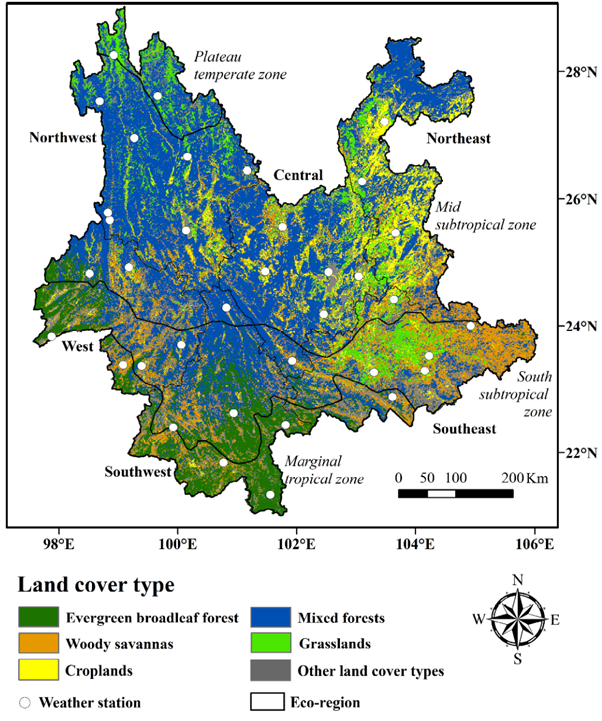

*Figure 4. Land cover map of Yunnan based on MODIS Land Surface Type data product -MCD12Q1. Figure reproduced from Kim et al. (2017) [[4]](https://doi.org/10.1007/s11629-016-3971-x).*

*Figure 3* shows LAI maps for August 10 from 2007 to 2013, comparing the conservative and relaxed filters. August 10 was chosen to exemplify differences in data completeness depending on the filter used beacuse it falls within the wet season and has low completeness under the conservative filter, as shown in *Figure 1*. The results highlight a strong contrast between the two approaches: the conservative filter produces highly incomplete maps across much of Yunnan in all years, whereas the relaxed filter provides nearly complete spatial coverage.

In some years, the conservative filter shows higher completeness in eastern Yunnan, where cropland, woody savannas, and grasslands are more prevalent than elsewhere in the province. Missing data under the conservative filter occur throughout Yunnan, particularly in high-LAI regions such as the mixed and evergreen forests in the west and southwest (see *Figure 4*).

(section-3)=
### 3. Drought effect on LAI

#### Spatial and monthly mean

Yunnan Province is positioned at the intersection of two major monsoon systems, the Indian monsoon and the East Asian monsoon, as well as the Qinghai-Tibet Plateau [[3]](https://doi.org/10.1016/j.chnaes.2013.09.004). These monsoons bring heavy rainfall during a distinct wet season, but due to the region’s varied topography, precipitation is unevenly distributed, often leading to water shortages during the dry season. Natural vegetation and wetlands help buffer this imbalance by storing and gradually releasing water. However, ongoing droughts have revealed the degradation of these ecosystems. Climate change is expected to intensify both the frequency and severity of droughts across Southeast Asia, including Yunnan [[4]](https://doi.org/10.1007/s11629-016-3971-x). 

Yunnan has historically faced frequent droughts, with severe events occurring every two to three years between 1950 and 2014. The drought from autumn 2009 to spring 2010 was the most extreme since meteorological records began in 1959. It caused widespread ecological and agricultural disruption—drying up rivers and reservoirs, triggering large-scale crop failures, leading to the death of rare plant species, and altering water quality in plateau lakes [[1]](https://doi.org/10.1038/s41598-024-58068-w). 

Drought impacts on vegetation—such as reduced leaf growth, early senescence, and plant mortality—can be detected at regional scales using satellite-derived Leaf Area Index (LAI) data [[4]](https://doi.org/10.1007/s11629-016-3971-x). In the specific case of Yunnan, commonly used products include GLASS LAI (derived from MODIS surface reflectance) [[4]](https://doi.org/10.1007/s11629-016-3971-x) and MODIS LAI [[1]](https://doi.org/10.1038/s41598-024-58068-w), both of which are valuable for monitoring vegetation responses to drought.

Monthly mean LAI over Yunnan was calculated for each year from 2007 to 2013 to assess whether values in 2009 and 2010 were lower than in other years. These means were derived using both the relaxed and conservative filters to test whether the results support the earlier observations from Figures 3 and 4, namely, that the conservative filter tends to filter out high-LAI areas during the wet season, thereby lowering mean values compared with the relaxed filter.

In [58]:
def monthly_mean_by_year(ds, variable="LAI", diagnostics=None):

    # --- Step 1: Compute spatial mean ---
    lai_mean_spatial = diagnostics.spatial_weighted_mean(ds[variable])

    # Add year & month coords
    lai_mean_spatial = lai_mean_spatial.assign_coords(
        month=lai_mean_spatial["time"].dt.month,
        year=lai_mean_spatial["time"].dt.year
    )

    # --- Step 2: Group by year/month and average ---
    monthly_mean = lai_mean_spatial.groupby(["year", "month"]).mean()

    # Convert to tidy DataFrame
    monthly_df = monthly_mean.compute().to_pandas().unstack(level=0)

    # Convert Series with MultiIndex to DataFrame
    monthly_df = monthly_df.reset_index()
    
    # Rename columns properly
    monthly_df.columns = ['month', 'year', 'LAI']

    return monthly_df

In [59]:
df_means_conservative = monthly_mean_by_year(ds_conservative, variable="LAI", diagnostics=diagnostics)

In [60]:
df_means_relaxed = monthly_mean_by_year(ds_relaxed, variable="LAI", diagnostics=diagnostics)

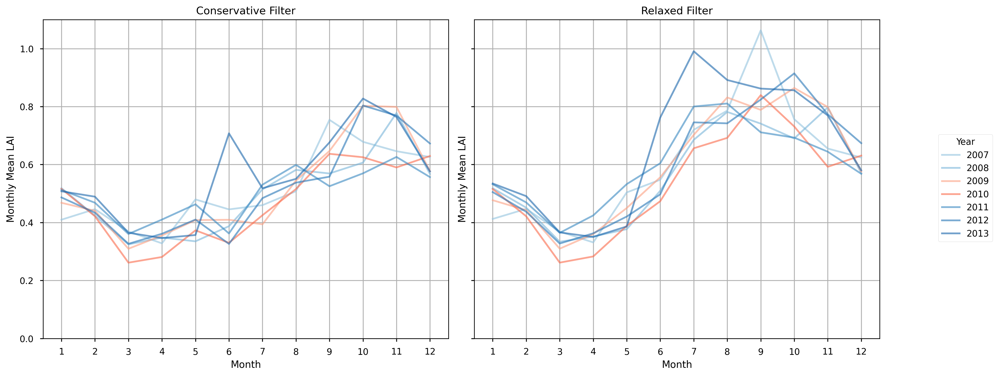

In [61]:
# Setup subplots: two side-by-side plots with shared y-axis
fig, axes = plt.subplots(1, 2, figsize=(14, 6), dpi=250, sharey=True)

# Common years (assuming both dataframes cover the same years)
years = sorted(df_means_conservative['year'].unique())

# Normalize colormap
norm = mcolors.Normalize(vmin=min(years), vmax=max(years))

# Loop through both DataFrames and corresponding subplot axes
for ax, (df, title) in zip(
    axes,
    [(df_means_conservative, "Conservative Filter"),
     (df_means_relaxed, "Relaxed Filter")]
):
    for year in years:
        subset = df[df['year'] == year]
        color_val = norm(year)
        
        # Blue for most years, red for specific years
        if year in [2009, 2010]:
            color = cm.Reds(norm(year))
        else:
            color = cm.Blues(0.4 + 0.4 * color_val)  # restrict to 0.4–0.8 range
        
        ax.plot(subset['month'], subset['LAI'],
                color=color, linewidth=2, label=str(year), alpha=0.6)
    
    ax.set_xlabel("Month")
    ax.set_ylabel("Monthly Mean LAI")
    ax.set_title(title)
    ax.set_xticks(range(1, 13))
    ax.set_ylim(0, 1.1)
    ax.grid(True)

# Create a shared legend outside the plots
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, title="Year",
           bbox_to_anchor=(1.05, 0.5), loc="center left")

plt.tight_layout()
plt.show()


*Figure 5. Monthly mean LAI from 2007–2013 under conservative (left) and relaxed (right) filters, plotted by calendar month with consistent year-wise color coding.*

Under the relaxed filter (right panel of *Figure 5*), the values for 2009 appear to fall within the typical range for that time of year compared with other non-drought years. In contrast, many months in 2010 show visibly lower values than the corresponding months in other years. This pattern may reflect the delayed impact of the drought, with vegetation stress becoming more pronounced over time. Moreover, because the spatial mean represents an average across a large and ecologically diverse region, localized drought effects in 2009 may have been masked in the overall mean.

As expected, the conservative filter produces mean LAI values similar to those from the relaxed filter in months with high data completeness (November to April). However, in months with low completeness, the conservative filter yields noticeably lower mean LAI values. This effect is especially evident from June to August, during the wet season, when high-LAI vegetation may be disproportionately excluded by the conservative filter (see *Figures 3 and 4*). In 2010, mean LAI values are still reduced relative to other years, though the effect is observed in fewer months than when using the relaxed filter.

#### Standardized LAI anomaly

Zhang et al. (2024) [[1]](https://doi.org/10.1038/s41598-024-58068-w) sinvestigated the effects of drought on vegetation in the Tropic of Cancer zone of Yunnan. To achieve this, they used various vegetation health indicators, including the LAI, which was obtained from the MOD15A2H product (layer name: LAI_500m). They calculated the monthly LAI anomaly for the drought period from August 2009 to October 2010. The reference periods 2007–2008 and 2012–2013 were chosen because they experienced minimal drought events and are adjacent to the drought years under investigation (2009–2010). This proximity helps control for long-term changes, such as those driven by human activity, that might otherwise skew the analysis [[1]](https://doi.org/10.1038/s41598-024-58068-w). For example, northwestern Yunnan was a key region in the Grain-for-Green Programme, which may have significantly influenced vegetation dynamics [[5]](https://doi.org/10.1016/j.scitotenv.2016.09.026). 

In this study, the same approach will be applied using the C3S LAI product with the relaxed filter, and the results will be compared with those of Zhang et al. (2024). The following standardized anomaly equation was used:

$\text{LAI anomaly} = \frac{\text{LAI}_t - \overline{\text{LAI}}}{\delta_{\text{LAI}}}$

where:

$\text{LAI}_t$ = LAI 2010 for a specific month for that pixel

$\overline{\text{LAI}}$ = Mean LAI 2007-2008 and 2012-2013 for that same month for that pixel

$\delta_{\text{LAI}}$ = Standard deviation LAI 2007-2008 and 2012-2013 for that same month for that pixel

In [9]:
# Extract LAI data
da = ds_relaxed["LAI"]

# --- Step 1. Clip to geographic range (Tropic of Cancer region in Yunnan) ---
da = da.sel(
    longitude=slice(98.811, 106.194),
    latitude=slice(24.179, 22.815)
)

# --- Step 2. Define normal period (2007–2008 and 2012–2013) ---
da_normal = da.sel(
    time=((da.time.dt.year >= 2007) & (da.time.dt.year <= 2008)) |
         ((da.time.dt.year >= 2012) & (da.time.dt.year <= 2013))
)

# --- Step 3. Compute monthly climatology (mean + std) ---
mean_normal = da_normal.groupby("time.month").mean(dim="time")
std_normal  = da_normal.groupby("time.month").std(dim="time")

# --- Step 4. Select target years (2009 and 2010) ---
da_2009 = da.sel(time=da.time.dt.year == 2009)
da_2010 = da.sel(time=da.time.dt.year == 2010)

# --- Step 5. Compute monthly means for each year ---
lai_2009 = da_2009.groupby("time.month").mean(dim="time")
lai_2010 = da_2010.groupby("time.month").mean(dim="time")

# --- Step 6. Calculate standardized monthly anomaly (SMA) ---
std_normal_safe = std_normal.where(std_normal != 0)

lai_anom_2009 = (lai_2009 - mean_normal) / std_normal_safe
lai_anom_2010 = (lai_2010 - mean_normal) / std_normal_safe

# Avoid inf/-inf
lai_anom_2009 = lai_anom_2009.where(np.isfinite(lai_anom_2009))
lai_anom_2010 = lai_anom_2010.where(np.isfinite(lai_anom_2010))

In [30]:
# --- Custom colormap ---
colors = [
    "#b05943",  # < -2
    "#da7426",  # -2 to -1.5
    "#f1a41c",  # -1.5 to -1
    "#f4d90b",  # -1 to -0.5
    "#c7f310",  # -0.5 to 0
    "#36df10",  # 0 to 0.5
    "#0dc53f",  # 0.5 to 1
    "#1b9f84",  # 1 to 1.5
    "#126d8d",  # 1.5 to 2
    "#0f2f6d"   # > 2
]

bounds = [-100, -2, -1.5, -1, -0.5, 0, 0.5, 1, 1.5, 2, 100]

cmap = mcolors.ListedColormap(colors)
cmap.set_bad(color='lightgray')
norm = mcolors.BoundaryNorm(bounds, ncolors=len(colors), clip=True)

In [31]:
import warnings
warnings.filterwarnings("ignore", message="invalid value encountered in cast")

/data/wp5/.tmp/ipykernel_15181/4087124608.py:72: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.2, 1, 0.99])


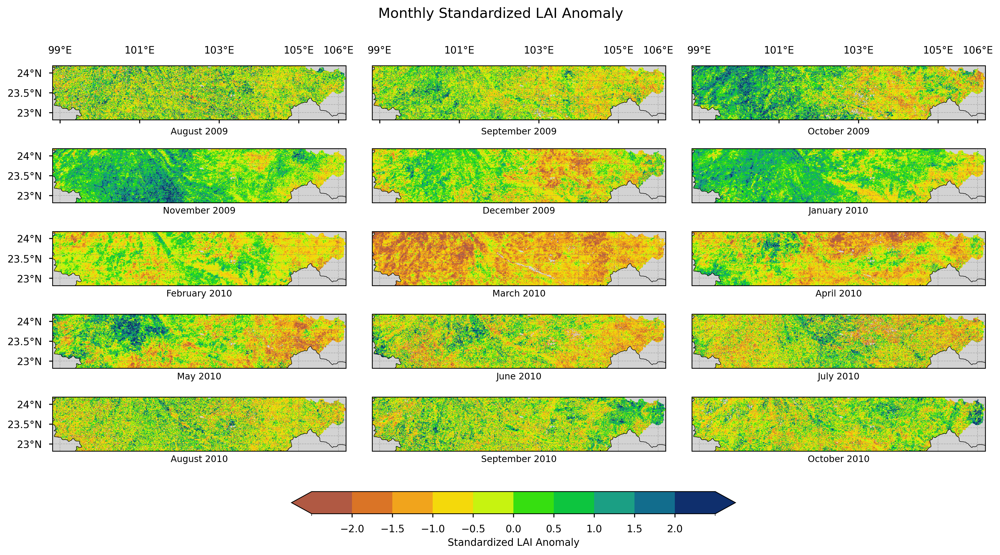

In [14]:
da_period = da_period.where(np.isfinite(da_period))
# --- Subset anomalies to Aug 2009 – Oct 2010 ---
da_period = xr.concat(
    [lai_anom_2009.sel(month=slice(8, 12)),  # Aug–Dec 2009
     lai_anom_2010.sel(month=slice(1, 10))], # Jan–Oct 2010
    dim="month"
)

# Time labels for subplot titles
time_labels = [f"2009-{m:02d}" for m in range(8, 13)] + \
              [f"2010-{m:02d}" for m in range(1, 11)]

# --- Set up 3×4 subplot grid ---
fig, axes = plt.subplots(
    nrows=5, ncols=3,
    figsize=(14, 8),
    subplot_kw={'projection': ccrs.PlateCarree()},
    dpi=250
)
axes = axes.flatten()

# --- Plot each month ---
for idx, ax in enumerate(axes[:15]):
    data = da_period.isel(month=idx)

    im = ax.pcolormesh(
        da_period.longitude, da_period.latitude, data,
        cmap=cmap, norm=norm,
        transform=ccrs.PlateCarree()
    )

    # Set to the Tropic of Cancer rectangle
    ax.set_extent([98.811, 106.194, 22.815, 24.179], crs=ccrs.PlateCarree())
    ax.add_feature(cfeature.BORDERS, linestyle='-', edgecolor='black', linewidth=0.5)

    # --- Date label under each subplot ---
    year, month = map(int, time_labels[idx].split("-"))
    month_name = calendar.month_name[month]
    ax.set_xlabel(f"{month_name} {year}", fontsize=9, labelpad=4)

    # --- Gridlines ---
    ax.gridlines(draw_labels=False, linewidth=0.5, color="gray", alpha=0.5, linestyle="--")

    # --- Longitude ticks only for top row ---
    if idx < 3:  # top row (idx = 0,1,2)
        xticks = [99, 101, 103, 105, 106]
        ax.set_xticks(xticks, crs=ccrs.PlateCarree())
        ax.xaxis.set_major_formatter(LongitudeFormatter(degree_symbol="°"))
        ax.tick_params(axis="x", labelbottom=False, labeltop=True)  # move ticks to top
    else:
        ax.set_xticks([])

    # --- Latitude ticks for left column only ---
    if idx % 3 == 0:  # left column
        yticks = [23.0, 23.5, 24.0]
        ax.set_yticks(yticks, crs=ccrs.PlateCarree())
        ax.yaxis.set_major_formatter(LatitudeFormatter(degree_symbol="°"))
    else:
        ax.set_yticks([])

# --- Shared colorbar at bottom ---
cbar = fig.colorbar(
    im, ax=axes, orientation="horizontal",
    fraction=0.05, pad=0.08, shrink=0.9,
    ticks=bounds[1:-1], extend="both"
)
cbar.set_label("Standardized LAI Anomaly", fontsize=10)

# --- Main title ---
fig.suptitle("Monthly Standardized LAI Anomaly", fontsize=14, y=0.99)

plt.tight_layout(rect=[0, 0.2, 1, 0.97]) 
plt.show()

*Figure 6. Monthly standardized LAI anomalies during the drought period from August 2009 to October 2010, calculated using the C3S LAI product (relaxed quality filter).*

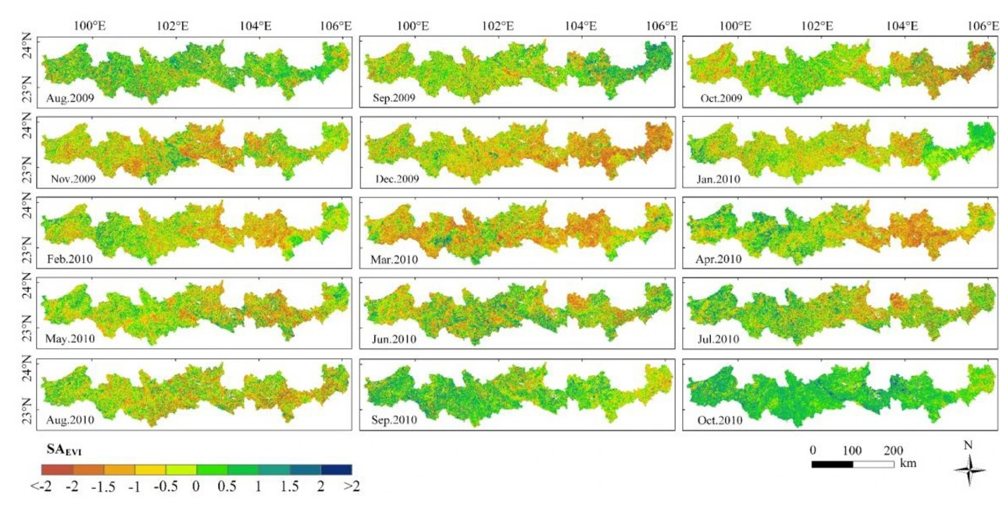

*Figure 7. Monthly standardized LAI anomalies during the drought period from August 2009 to October 2010, based on the MOD15A2H product. Source: Zhang et al. (2024) [[1]](https://doi.org/10.1038/s41598-024-58068-w)*

According to the Standardized Precipitation Evapotranspiration Index (SPEI) calculated by Zhang et al. (2024) [[1]](https://doi.org/10.1038/s41598-024-58068-w), the drought fully developed across the study area between October 2009 and February 2010. Because LAI has a lagged response to drought, the results obtained with the C3S product (*Figure 6*) are consistent: March 2010 shows the largest areas with negative anomalies, with adjacent months also displaying widespread negative values. These findings align with Zhang et al. (2024) [[1]](https://doi.org/10.1038/s41598-024-58068-w), who reported that the period of greatest vegetation stress due to the cumulative effects of drought occurred between March and May 2010, corresponding to spring.

Some differences can be observed between the *Figure 6* (C3S) and *Figure 7* (MODIS). C3S LAI anomalies then to show more extremes (values <-2 or 2>) than the anomamlies calculated using MODIS. For example, it can be noted that the anomalies in March 2010 using the C3S were even more negative than the ones using MODIS. Also, the C3S data show positive anomalies in the western part of the study area during October and November 2009, as well as January and May 2010—patterns that are absent in the MODIS results. Another difference is that, according to MODIS, vegetation LAI had largely returned to normal conditions by October 2010, whereas the C3S data still indicate scattered pixels with negative anomalies.

Although LAI responds more slowly to drought because it reflects cumulative canopy biomass rather than immediate physiological stress, it tends to recover relatively quickly once water availability improves, since canopy structure is often not severely damaged in the short term. In contrast, gross primary productivity (GPP) responds directly to water stress and requires more time to recover, as plants must restore physiological functions such as stomatal conductance and photosynthetic activity. This makes GPP a more sensitive indicator of drought impacts and a better tool for identifying the regions most affected [[1]](https://doi.org/10.1038/s41598-024-58068-w). Nevertheless, LAI remains valuable for assessing longer-term structural changes in vegetation and for linking drought effects to phenological dynamics and canopy development.

## ℹ️ If you want to know more

* Zhu, H. & Tan, Y. (2022). Flora and Vegetation of Yunnan, Southwestern China: Diversity, Origin and Evolution. Diversity, 14(5), 340. [](https://doi.org/10.3390/d14050340)
* Qian, L.-S., Chen, J.-H., Deng, T., & Sun, H. (2020). Plant diversity in Yunnan: Current status and future directions. Plant Diversity, 42(4), 281–291. [](https://doi.org/10.1016/j.pld.2020.07.006)
* Lan, T., & Yan, X. (2024). Analysis of drought characteristics and causes in Yunnan Province in the last 60 years (1961–2020). Journal of Hydrometeorology, 25, 177–190. [](https://doi.org/10.1175/JHM-D-23-0092.1) 

### Key resources

Code libraries used:
* [C3S EQC custom functions](https://github.com/bopen/c3s-eqc-automatic-quality-control/tree/main/c3s_eqc_automatic_quality_control), `c3s_eqc_automatic_quality_control`,  prepared by [B-Open](https://www.bopen.eu/)

Documentation:
* [Product User Guide and Specification (PUGS) - Multi-sensor CDR LAI and fAPAR v3.0](https://dast.copernicus-climate.eu/documents/satellite-lai-fapar/D3.3.9-v3.0_PUGS_CDR_LAI_FAPAR_MULTI_SENSOR_v3.0_PRODUCTS_v1.0.1.pdf)
* [Algorithm Theoretical Basis Document (ATBD) - Multi-sensor CDR LAI and fAPAR v3.0](https://dast.copernicus-climate.eu/documents/satellite-lai-fapar/D1.4.4-v3.0_ATBD_CDR_LAI_FAPAR_MULTI_SENSOR_v3.0_PRODUCTS_v1.0.1.pdf)
* [Product Quality Assurance Document (PQAD) - Multi-sensor LAI and fAPAR v3.0](https://dast.copernicus-climate.eu/documents/satellite-lai-fapar/D2.2.9-v3.0_PQAD_CDR_LAI_FAPAR_MULTI_SENSOR_v3.0_PRODUCTS_v1.1.pdf)
* [Product Quality Assessment Report (PQAR) - Multi-sensor LAI and fAPAR v3.0](https://dast.copernicus-climate.eu/documents/satellite-lai-fapar/D2.3.9-v3.0_PQAR_CDR_LAI_FAPAR_MULTI_SENSOR_v3.0_PRODUCTS_v1.1.pdf)

### References

[[1]](https://doi.org/10.1038/s41598-024-58068-w) Zhang, Y., Gu, T., He, S., Cheng, F., Wang, J., Ye, H., Zhang, Y., Su, H., & Li, Q. (2024). Extreme drought along the tropic of cancer (Yunnan section) and its impact on vegetation. Sci Rep 14, 7508.

[[2]](https://gadm.org) GADM. (2023). GADM database of global administrative areas (version 4.1). Data accessed via UC Davis GeoData repository.

[[3]](https://doi.org/10.1016/j.chnaes.2013.09.004) Yu, W., Shao, M., Ren, M., Zhou, H., Jiang, Z., & Li, D. (2013). Analysis on spatial and temporal characteristics of drought in Yunnan Province. Acta Ecologica Sinica, 33(6), 317–324.

[[4]](https://doi.org/10.1007/s11629-016-3971-x) Kim, K., Wang, M.-c., Ranjitkar, S., Liu, S.-h., Xu, J.-c., & Zomer, R. J. (2017). Using leaf area index (LAI) to assess vegetation response to drought in Yunnan province of China. J. Mt. Sci. 14, 1863–1872.

[[5]](https://doi.org/10.1016/j.scitotenv.2016.09.026) Wang, J., Peng, J., Zhao, M., Liu, Y., & Chen, Y. (2017). Significant trade-off for the impact of Grain-for-Green Programme on ecosystem services in North-western Yunnan, China. Science of The Total Environment, 574, 57–64.